# DAT16 Lab 10
## Ensemble Methods: Aggregating Models

Justin Breucop

Today's lab covers:
1. Investigating the Decision Boundaries
2. Growing a Random Forest

The theory used to introduce these concepts can be a bit high level. We postulate a theoretical *true* classification **f** function that perfectly labels a data point given a large enough set of input features. We try to come as close as possible to this **f** with our learned classifier **h**. 

The concept of our *hypothesis space* is what we explore when we take our data, learn a model, and determine the "score" of our model. In theory, a cross validated score of 100 is as close as we can get to **f** and all these improvements we make to our classifiers are moving through the hypothesis space, approaching **f**.

This theoretical component has no true lab but in a sense is every lab that we've covered. Whenever we compare the performance of two separate models, we are comparing the difference from two distinct starting points in the hypothesis space.

A way to demonstrate this will be the basis of the first part of our lab.


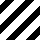
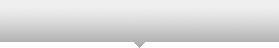
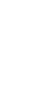
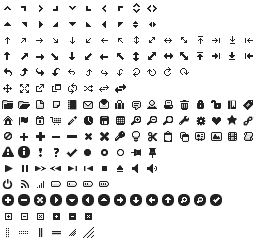
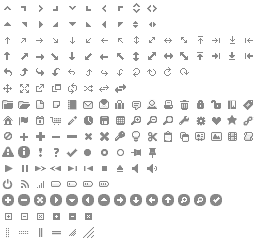
...
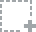
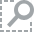
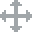
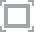
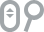

In [1]:
import numpy as np
import pandas as pd

from sklearn.cross_validation import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.lda import LDA
from sklearn.qda import QDA

from bokeh.plotting import figure,gridplot,show,output_notebook
from bokeh.models import Range1d
output_notebook()

%matplotlib inline

##Investigating Decision Boundaries
Visually understanding how some classifiers make decisions; adapted from an sklearn page, which will be shared after lab. 

The goal here is to investigate the code and describe in layman's terms what is happening in the specific chunk. If there is a variable being referenced outside of your chunk, or your in a loop, refer to what's happening in one iteration of the loop.

In [2]:

# ====================================================================== #
# Part 1

names = ["Nearest Neighbors", "Linear SVM", "RBF SVM", "Decision Tree",
         "Random Forest", "AdaBoost", "Naive Bayes", "LDA", "QDA"]
classifiers = [
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    AdaBoostClassifier(),
    GaussianNB(),
    LDA(),
    QDA()]

X, y = make_classification(n_features=2, n_redundant=0, n_informative=2,
                           random_state=1, n_clusters_per_class=1)
rng = np.random.RandomState(2)
X += 2 * rng.uniform(size=X.shape)
linearly_separable = (X, y)

datasets = [make_moons(noise=0.3, random_state=0),
            make_circles(noise=0.2, factor=0.5, random_state=1),
            linearly_separable
            ]



In [24]:
y

[0.67893603311172079,
 0.67558400687711517,
 0.68796281421256278,
 0.69137161778531497,
 0.6969770411736772,
 0.69587241873233685,
 0.68344325298329267,
 0.66217033414225956,
 0.68908690620958246,
 0.6689183970278606,
 0.65774528359766182,
 0.67115938189657598,
 0.66781998072904081,
 0.67566638898611842,
 0.6543305575917614,
 0.66221441548599236,
 0.66439869394390416,
 0.6734065019804687,
 0.67453644548329361,
 0.66663982066730565,
 0.67225765634070933,
 0.68238292466771422,
 0.67222648377341976,
 0.65429261146320628,
 0.66668383108369533,
 0.66553498544393608,
 0.67560975350265817,
 0.65880596654995582,
 0.66441146086566105,
 0.6654965428239793,
 0.66551594145231541,
 0.68013566272913528,
 0.65993605190746685,
 0.66661442867847831,
 0.67228290647485078,
 0.67675218021786754,
 0.66663960788527654,
 0.66210749251627876,
 0.6554540112426932,
 0.66999798211708894,
 0.6588436289691384,
 0.66328151736283625,
 0.67229546061457834,
 0.66660829346330053,
 0.66328772350535703,
 0.66890584288813

Describe here what is going on:

In [3]:
full_grid = []
for data in datasets:
# ====================================================================== #
# Part 2

    h = .02  # step size in the meshgrid
    
    X, y = data
    X = StandardScaler().fit_transform(X)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.4)

    x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5
    y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))

    raw = figure(title="Raw Data", tools='',
                x_range=(xx.min(), xx.max()), 
                y_range=(yy.min(), yy.max()),
                width=180, plot_height=220,
                min_border=1,
                title_text_font_size='10pt' )

    color_dict = {0:'blue',1:'red'}

    train_colors = [color_dict[label] for label in y_train]
    raw.circle(X_train[:, 0], X_train[:, 1], 
               color=train_colors)

    test_colors = [color_dict[label] for label in y_test]
    raw.circle(X_test[:, 0], X_test[:, 1], 
               color=test_colors, alpha=0.6)


    
# ====================================================================== #
# Part 3

    row=[raw]
    for name, clf in zip(names, classifiers):
        clf.fit(X_train, y_train)
        score = clf.score(X_test, y_test)

        if hasattr(clf, "decision_function"):
            Z = clf.decision_function(np.c_[xx.ravel(), yy.ravel()])
        else:
            Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]

        
        Z = Z.reshape(xx.shape)
        Z = Z/Z.max()
        control_row = np.ones(Z.shape[1])+0.001
        #NOTE: control row adds a max value outside of the grid to correct colors. 
        # Don't worry about explaining control_row
        Z = np.vstack((Z,control_row))


        p1 = figure(title=name, tools='',
                    x_range=(xx.min(), xx.max()), 
                    y_range=(yy.min(), yy.max()),
                    width=180, plot_height=220,
                    min_border=1,
                    title_text_font_size='10pt')


        p1.image(image=[Z], x=[xx.min()], y=[yy.min()], dw=[xx.max()-xx.min()], dh=[yy.max()-yy.min()],
                palette='RdYlBu11')

        p1.circle(X_train[:, 0], X_train[:, 1], 
                  color=train_colors,
                  line_color='black',
                  size=3)
        p1.circle(X_test[:, 0], X_test[:, 1], 
                  color=test_colors, 
                  alpha=0.6,
                  line_color='black',
                  size=3)

        p1.text(x=[xx.max()-1.5],y=[yy.min()],
                text=[str(score)],
                text_font_size='15pt',
                text_font_style='bold')
        
        row.append(p1)
    
    grid = np.array(row).reshape(2,len(row)/2)
    full_grid.append(grid)
    
final_grid = np.vstack(full_grid)
show(gridplot(final_grid.tolist()))

In [25]:
xx

array([[-3.07292199, -3.05292199, -3.03292199, ...,  2.16707801,
         2.18707801,  2.20707801],
       [-3.07292199, -3.05292199, -3.03292199, ...,  2.16707801,
         2.18707801,  2.20707801],
       [-3.07292199, -3.05292199, -3.03292199, ...,  2.16707801,
         2.18707801,  2.20707801],
       ..., 
       [-3.07292199, -3.05292199, -3.03292199, ...,  2.16707801,
         2.18707801,  2.20707801],
       [-3.07292199, -3.05292199, -3.03292199, ...,  2.16707801,
         2.18707801,  2.20707801],
       [-3.07292199, -3.05292199, -3.03292199, ...,  2.16707801,
         2.18707801,  2.20707801]])

In [16]:
x_min

-3.0729219947849753

In [17]:
x_max

2.2174813351406897

###Random Forests
Random forests are a type of ensemble method (which we hinted at above) that build out groups of decision trees

In [45]:
from sklearn.cross_validation import ShuffleSplit

titanic = pd.read_csv('titanic-train.csv')
titanic.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 891 entries, 0 to 890
Data columns (total 12 columns):
PassengerId    891 non-null int64
Survived       891 non-null int64
Pclass         891 non-null int64
Name           891 non-null object
Sex            891 non-null object
Age            714 non-null float64
SibSp          891 non-null int64
Parch          891 non-null int64
Ticket         891 non-null object
Fare           891 non-null float64
Cabin          204 non-null object
Embarked       889 non-null object
dtypes: float64(2), int64(5), object(5)
memory usage: 90.5+ KB


In [46]:
titanic.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,631,1,1,"Barkworth, Mr. Algernon Henry Wilson",male,80.0,0,0,27042,30.0000,A23,S
1,852,0,3,"Svensson, Mr. Johan",male,74.0,0,0,347060,7.7750,NaN,S
2,97,0,1,"Goldschmidt, Mr. George B",male,71.0,0,0,PC 17754,34.6542,A5,C
3,494,0,1,"Artagaveytia, Mr. Ramon",male,71.0,0,0,PC 17609,49.5042,NaN,C
4,117,0,3,"Connors, Mr. Patrick",male,70.5,0,0,370369,7.7500,NaN,Q


Let's preprocess our data. Age needs to be imputed or dropped, Sex needs to be converted to a boolean data type, and to use our categorical feature `Embarked` we must use `pd.get_dummies` on it

In [47]:
average_age = titanic['Age'].mean()
titanic['Age'] = titanic['Age'].fillna(average_age)

In [48]:
titanic['is_female'] = titanic.Sex=='female'
titanic.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,is_female
0,631,1,1,"Barkworth, Mr. Algernon Henry Wilson",male,80.0,0,0,27042,30.0000,A23,S,False
1,852,0,3,"Svensson, Mr. Johan",male,74.0,0,0,347060,7.7750,NaN,S,False
2,97,0,1,"Goldschmidt, Mr. George B",male,71.0,0,0,PC 17754,34.6542,A5,C,False
3,494,0,1,"Artagaveytia, Mr. Ramon",male,71.0,0,0,PC 17609,49.5042,NaN,C,False
4,117,0,3,"Connors, Mr. Patrick",male,70.5,0,0,370369,7.7500,NaN,Q,False


In [49]:
embarked_categories = pd.get_dummies(titanic.Embarked,prefix='Embarked')
titanic[embarked_categories.columns] = embarked_categories
titanic.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,is_female,Embarked_C,Embarked_Q,Embarked_S
0,631,1,1,"Barkworth, Mr. Algernon Henry Wilson",male,80.0,0,0,27042,30.0000,A23,S,False,0,0,1
1,852,0,3,"Svensson, Mr. Johan",male,74.0,0,0,347060,7.7750,NaN,S,False,0,0,1
2,97,0,1,"Goldschmidt, Mr. George B",male,71.0,0,0,PC 17754,34.6542,A5,C,False,1,0,0
3,494,0,1,"Artagaveytia, Mr. Ramon",male,71.0,0,0,PC 17609,49.5042,NaN,C,False,1,0,0
4,117,0,3,"Connors, Mr. Patrick",male,70.5,0,0,370369,7.7500,NaN,Q,False,0,1,0


In [50]:
feature_columns = 'Age,Parch,Pclass,Fare,Embarked_C,Embarked_Q,Embarked_S'.split(',')
for train,test in ShuffleSplit(len(titanic),test_size=.2,n_iter = 1):

    X_train = titanic[feature_columns].iloc[train]
    y_train = titanic['Survived'].iloc[train]
    X_test = titanic[feature_columns].iloc[test]
    y_test = titanic['Survived'].iloc[test]
    
  

In [51]:
# We already imported the RandomForest above, but here it is for reference:
# from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier

rfc = RandomForestClassifier(max_depth=5, n_estimators=10, max_features=3)
rfc.fit(X_train,y_train)
rfc.score(X_test,y_test)

0.7039106145251397

This is an interesting general score but let's be more thorough and get a cross evaluation score, and see how it grows with the size of our forest (`n_estimators`).

In [52]:
from sklearn.cross_validation import cross_val_score

features = titanic[feature_columns]
target = titanic['Survived']

forest_size = range(2,100,2)
y = []
for i in forest_size:
    rfc = RandomForestClassifier(max_depth=5, n_estimators=i, max_features=4)
    accuracy = cross_val_score(rfc, features, target, cv=5).mean()
    
    y.append(accuracy)
p1 = figure(title='Random Forest Classifier performance',tools='')
p1.line(x=forest_size,y=y, color='green')


show(p1)

How does the classifier change as we allow for more complexity?  (i.e. deeper trees)

In [54]:
tree_depth = range(1,50)
y = []
for i in tree_depth:
    rfc = RandomForestClassifier(max_depth=i, n_estimators=20, max_features=4)
    accuracy = cross_val_score(rfc, features, target, cv=5).mean()
    
    y.append(accuracy)
p1 = figure(title='Random Forest Classifier performance',x_axis_label='Max Tree Depth',tools='')
p1.line(x=tree_depth,y=y, color='green')


show(p1)